In [1]:
import os
import re
import h5py as f
import pickle
import numpy as np
import cv2

In [2]:
path = '/home/mr1142/Documents/Data/models/neumonia'

In [3]:
onlyfiles = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

In [4]:
models = [file for file in onlyfiles if not bool(re.search('completo', file))]

In [5]:
models[0]

'prueba_EffNet3_fine-05_batch-8_lr-0001_auc-92.h5'

In [6]:
model_name = models[0]

In [7]:
os.environ['CUDA_VISIBLE_DEVICES'] = '3'

In [8]:
from tensorflow import keras

In [9]:
if bool(re.search('mask', model_name)):
    mask = True
else:
    mask = False

model = os.path.join('/home/mr1142/Documents/Data/models/neumonia', model_name)
model = keras.models.load_model(model)
dataframes = f.File("/home/rs117/covid-19/data/cxr_consensus_dataset_nocompr.h5", "r")
for key in dataframes.keys():
    globals()[key] = dataframes[key]


In [106]:
with open("/home/mr1142/Documents/img_class/indices/val_subset", "rb") as fp:
    index = pickle.load(fp)
index.sort()

In [10]:
def recolor_resize(img, pix=256):
    try:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    except:
        print('', end = '')
    img = cv2.resize(img, (pix, pix))
    img = np.expand_dims(img, axis=-1)
    return img

def des_normalize(img):
    return cv2.normalize(img, None, alpha = 0, beta = 255,
                         norm_type = cv2.NORM_MINMAX, dtype = cv2.CV_16UC1)

def normalize(img):
    return (img - np.mean(img))/ np.std(img)

In [11]:
def get_prepared_img(img, pix, mask = True):
    if mask:
        img = des_normalize(msk.apply_mask(img, model))
    img = recolor_resize(img, pix)
    img = normalize(img)
    return img

In [12]:
def img_predict(model, img, mask = False, pix = 512):
    img = get_prepared_img(img, pix, mask)
    return model.predict(img[np.newaxis,:])

def prediction_tensor(model, X, index, mask = False, pix = 512):
    y_pred = np.zeros((len(index), 3))
    for i in range(y_pred.shape[0]):
        y_pred[i,...] = img_predict(model, X[index[i]], mask, pix)
    return y_pred

def extract_max(array):
    for i in range(array.shape[0]):
        max = np.argmax(array[i,:])
        array[i,:] = 0
        array[i,max] = 1
    return array

In [107]:
np.random.shuffle(index)
index = index[0:50]

In [108]:
index.sort()

In [109]:
y_pred = prediction_tensor(model, X_train, index, mask)

In [110]:
y_real = y_train[index]

In [17]:
import matplotlib.pyplot as plt

In [21]:
from sklearn import metrics

fpr, tpr, thresholds = metrics.roc_curve(y_real[:,0], y_pred[:,0])
auc = metrics.roc_auc_score(y_real[:,0], y_pred[:,0])

In [111]:
def AUC_plot(fpr, tpr, auc, title):
    i = np.argmax(tpr-fpr)
    th = thresholds[i]
    x = fpr[i]
    y = tpr[i]
    plt.plot(fpr,tpr,label="AUC="+str(auc))
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.plot([x], [y], "ro", label="th="+str(round(th,2))) 
    plt.legend(loc=4)
    plt.title(title)
    return plt

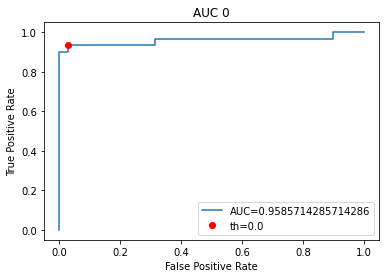

In [112]:
p = AUC_plot(fpr, tpr, auc, 'AUC 0')

In [55]:
p.savefig('AUC.png')

<Figure size 432x288 with 0 Axes>

In [61]:
plt.clf()

<Figure size 432x288 with 0 Axes>

In [113]:
precision, recall, thresholds = metrics.precision_recall_curve(y_real[:,0], y_pred[:,0])

In [120]:
def f1_score(precision, recall):
    return 2*(precision*recall)/(precision+recall)

In [121]:
np.argmax(f1_score)

0

No handles with labels found to put in legend.


Text(0.5, 1.0, 'Precision-Recall curve')

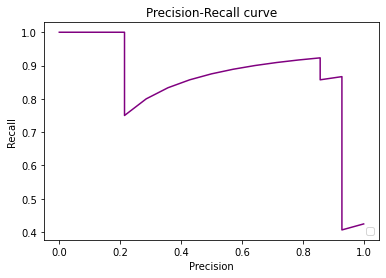

In [122]:
plt.plot(recall, precision, color='purple')
plt.ylabel('Recall')
plt.xlabel('Precision')
plt.legend(loc=4)
plt.title('Precision-Recall curve')

In [123]:
def plot_precision_recall_vs_threshold(precision, recall, thresholds):
    fig, ax = plt.subplots()
    f1 = f1_score(precision, recall)
    x_f = thresholds[np.argmax(f1)]
    y_f = f1[np.argmax(f1)]
    x = thresholds[np.where(precision == recall)]
    y = precision[np.where(precision == recall)]
    x_max = thresholds[np.argmax(precision+recall)]
    ax.axis([0 ,1, np.min(precision), 1])
    ax.plot(thresholds, precision[:-1], "r-", label="Precision", linewidth=2)
    ax.plot(thresholds, recall[:-1], "b-", label="Recall", linewidth=2)
    ax.plot(thresholds, f1[:-1], "m--", label="F1 score", linewidth=2)
    ax.plot([x], [y], "bo", label="th="+str(round(x[0],2)))
    try:
        ax.plot([x, x], [0, y], "k:")
    except:
        print('plot except')
    ax.plot([x_max, x_max], [0, 1], "k:")
    ax.plot([x_f], [y_f], "ro", label="th="+str(round(x_f,2))) 
    ax.set_xlabel("Threshold")
    ax.grid(True)
    ax.legend()
    return fig

/home/mr1142/miniconda3/envs/init/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


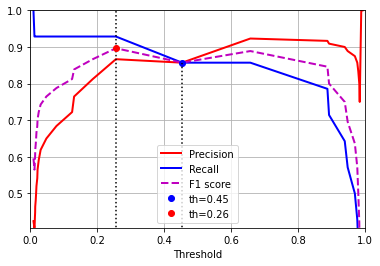

In [125]:
a = plot_precision_recall_vs_threshold(precision[0:50], recall[0:50], thresholds[0:49])

In [102]:
len(thresholds)

93

In [29]:
import pandas as pd
import numpy as np

In [44]:
df_old = pd.read_csv('/home/mr1142/Documents/Data/NIH/Data_Entry_2017.csv')

In [65]:
df_old

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y]
0,00000001_000.png,Cardiomegaly,0,1,58,M,PA,2682,2749,0.143,0.143
1,00000001_001.png,Cardiomegaly|Emphysema,1,1,58,M,PA,2894,2729,0.143,0.143
2,00000001_002.png,Cardiomegaly|Effusion,2,1,58,M,PA,2500,2048,0.168,0.168
3,00000002_000.png,No Finding,0,2,81,M,PA,2500,2048,0.171,0.171
4,00000003_000.png,Hernia,0,3,81,F,PA,2582,2991,0.143,0.143
...,...,...,...,...,...,...,...,...,...,...,...
112115,00030801_001.png,Mass|Pneumonia,1,30801,39,M,PA,2048,2500,0.168,0.168
112116,00030802_000.png,No Finding,0,30802,29,M,PA,2048,2500,0.168,0.168
112117,00030803_000.png,No Finding,0,30803,42,F,PA,2048,2500,0.168,0.168
112118,00030804_000.png,No Finding,0,30804,30,F,PA,2048,2500,0.168,0.168


In [6]:
df_new = pd.read_csv('/home/mr1142/Documents/Data/Data_Entry_2017_v2020.csv')

In [7]:
df_new

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y]
0,00000001_000.png,Cardiomegaly,0,1,57,M,PA,2682,2749,0.143,0.143
1,00000001_001.png,Cardiomegaly|Emphysema,1,1,58,M,PA,2894,2729,0.143,0.143
2,00000001_002.png,Cardiomegaly|Effusion,2,1,58,M,PA,2500,2048,0.168,0.168
3,00000002_000.png,No Finding,0,2,80,M,PA,2500,2048,0.171,0.171
4,00000003_001.png,Hernia,0,3,74,F,PA,2500,2048,0.168,0.168
...,...,...,...,...,...,...,...,...,...,...,...
112115,00030801_001.png,Mass|Pneumonia,1,30801,38,M,PA,2048,2500,0.168,0.168
112116,00030802_000.png,No Finding,0,30802,28,M,PA,2048,2500,0.168,0.168
112117,00030803_000.png,No Finding,0,30803,42,F,PA,2048,2500,0.168,0.168
112118,00030804_000.png,No Finding,0,30804,29,F,PA,2048,2500,0.168,0.168


In [9]:
set(df_old['Image Index']) - set(df_new['Image Index'])

set()

In [10]:
set(df_old['Finding Labels']) - set(df_new['Finding Labels'])

set()

In [19]:
list(set(df_old.columns) - set(df_new.columns))

['Unnamed: 11']

In [64]:
list(set(df_new.columns)-set(df_old.columns))

[]

In [48]:
df_old = df_old.drop('Unnamed: 11', axis = 1)

In [77]:
i=1
pic = df_old['Image Index'][i]

In [84]:
j = np.where(df_new['Image Index'] == pic)
j[0][0]

1

In [85]:
new = list(df_new.loc[j[0][0]])
old = list(df_old.loc[i])

In [86]:
print(new)
print(old)

['00000001_001.png', 'Cardiomegaly|Emphysema', 1, 1, 58, 'M', 'PA', 2894, 2729, 0.14300000000000002, 0.14300000000000002]
['00000001_001.png', 'Cardiomegaly|Emphysema', 1, 1, 58, 'M', 'PA', 2894, 2729, 0.14300000000000002, 0.14300000000000002]


In [63]:
old

['Image Index',
 'Finding Labels',
 'Follow-up #',
 'Patient ID',
 'Patient Age',
 'Patient Gender',
 'View Position',
 'OriginalImage[Width',
 'Height]',
 'OriginalImagePixelSpacing[x',
 'y]']

In [59]:
set(new)-set(old)

{0,
 0.14300000000000002,
 '00000001_000.png',
 1,
 2682,
 2749,
 57,
 'Cardiomegaly',
 'M',
 'PA'}

In [89]:
for i, pic in enumerate(df_old['Image Index']):
    j = np.where(df_new['Image Index'] == pic)[0]
    if len(j)>1:
        print(f'largo en {str(i)}')
    j = j[0]
    old = list(df_old.loc[i])
    new = list(df_new.loc[j])
    if old[1] != new[1]:
        print(i)
        print(old[1] + 'vs' + new[1])
    # if len(list(set(old) - set(new))) > 0:
    #     print(i)
    #     print(list(set(old) - set(new)))

In [107]:
import re
import os
import cv2
import matplotlib.pyplot as plt

In [113]:
names = [df_new['Image Index'][i] for i in df_new.index if bool(re.search('No Finding', df_new['Finding Labels'][i]))]

In [114]:
len(names)

60361

In [115]:
img_list = names[0:100]

In [116]:
def charge_ims(img_list):
    names = []
    imgs = []
    subfolders = [f.path for f in os.scandir('/home/mr1142/Documents/Data/NIH') if f.is_dir()]
    i = 0
    # De todas las imagenes que quiero cargar miro cuantas hay en cada carpeta y las cargo
    for folder in subfolders:
        folder_images = os.listdir(os.path.join(folder, 'images'))
        this_folder_imgs = set(img_list).intersection(folder_images)
        names = names + list(this_folder_imgs)
        for im in this_folder_imgs:
            i +=1
            imgs.append(cv2.imread(folder + '/images/' + im))
            print(str(i/len(img_list)*100) + '%', end = '; ')
    return {'name': names, 'imgs': imgs}

In [117]:
imgs = charge_ims(img_list)

1.0%; 2.0%; 3.0%; 4.0%; 5.0%; 6.0%; 7.000000000000001%; 8.0%; 9.0%; 10.0%; 11.0%; 12.0%; 13.0%; 14.000000000000002%; 15.0%; 16.0%; 17.0%; 18.0%; 19.0%; 20.0%; 21.0%; 22.0%; 23.0%; 24.0%; 25.0%; 26.0%; 27.0%; 28.000000000000004%; 28.999999999999996%; 30.0%; 31.0%; 32.0%; 33.0%; 34.0%; 35.0%; 36.0%; 37.0%; 38.0%; 39.0%; 40.0%; 41.0%; 42.0%; 43.0%; 44.0%; 45.0%; 46.0%; 47.0%; 48.0%; 49.0%; 50.0%; 51.0%; 52.0%; 53.0%; 54.0%; 55.00000000000001%; 56.00000000000001%; 56.99999999999999%; 57.99999999999999%; 59.0%; 60.0%; 61.0%; 62.0%; 63.0%; 64.0%; 65.0%; 66.0%; 67.0%; 68.0%; 69.0%; 70.0%; 71.0%; 72.0%; 73.0%; 74.0%; 75.0%; 76.0%; 77.0%; 78.0%; 79.0%; 80.0%; 81.0%; 82.0%; 83.0%; 84.0%; 85.0%; 86.0%; 87.0%; 88.0%; 89.0%; 90.0%; 91.0%; 92.0%; 93.0%; 94.0%; 95.0%; 96.0%; 97.0%; 98.0%; 99.0%; 100.0%; 

/home/mr1142/miniconda3/envs/init/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


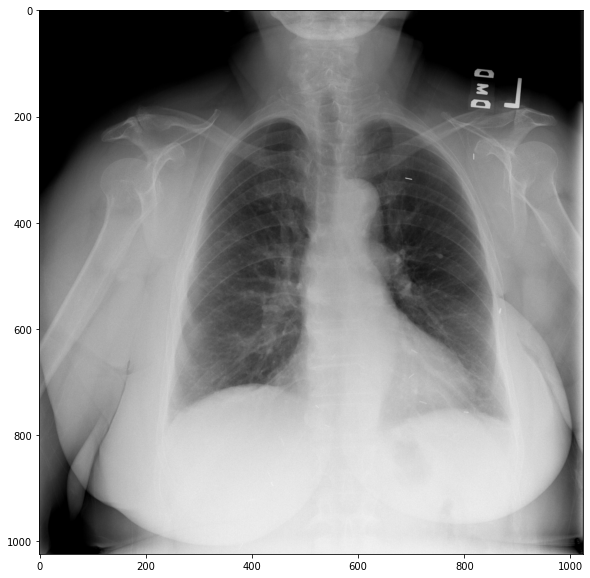

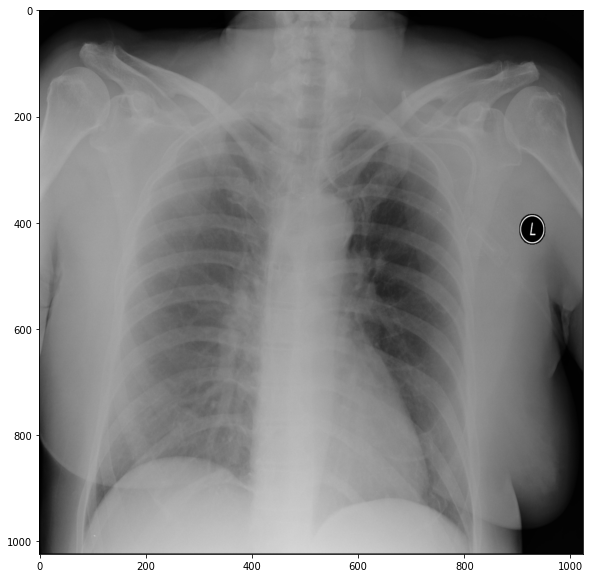

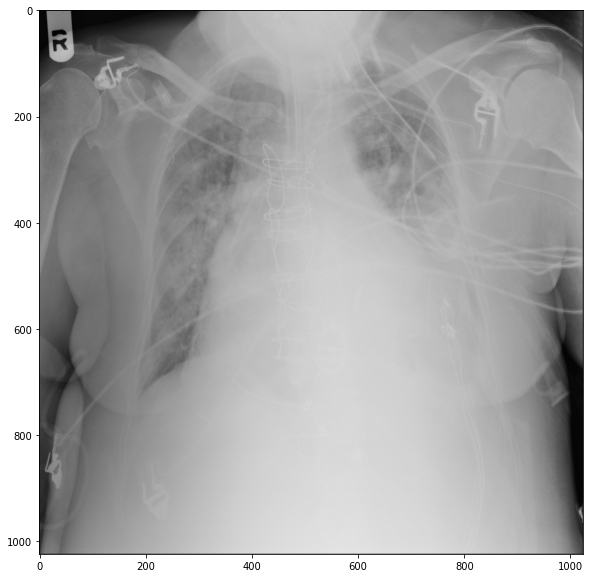

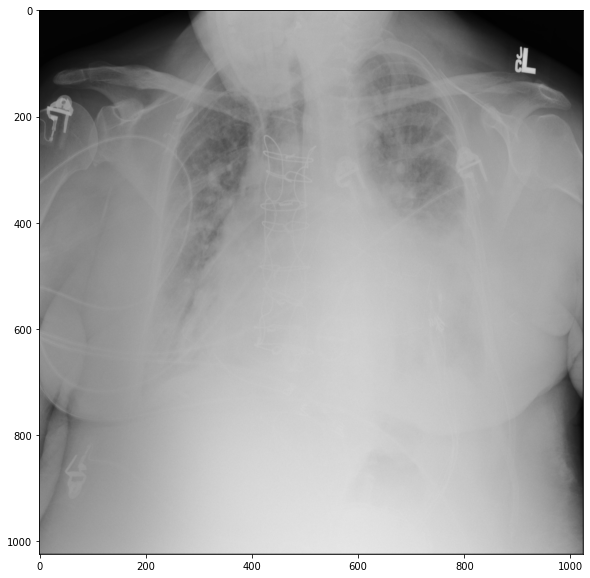

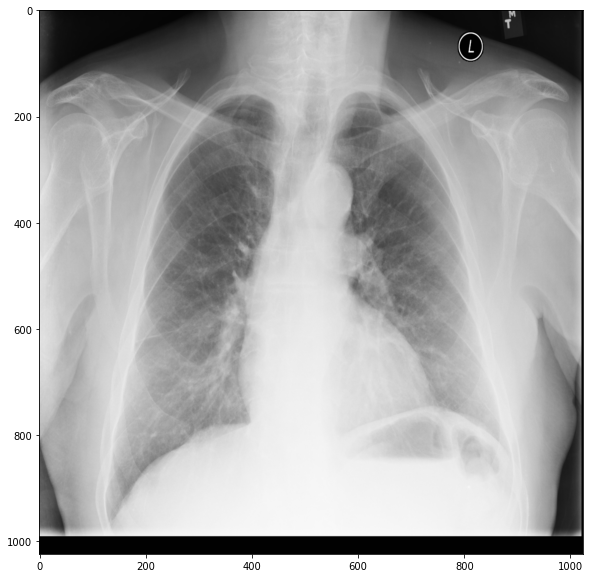

...

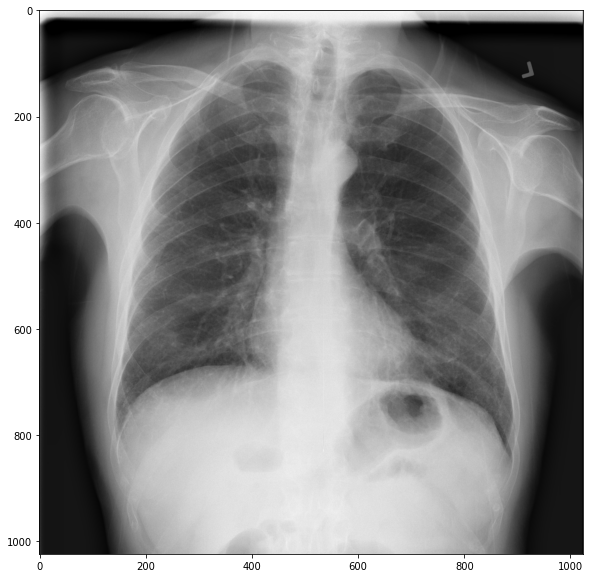

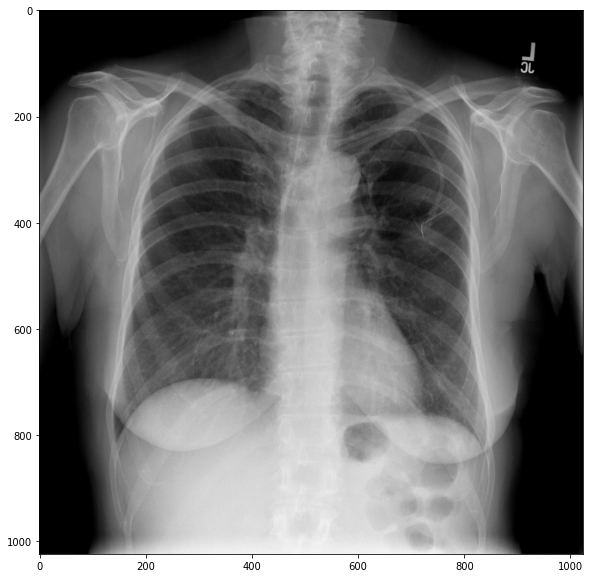

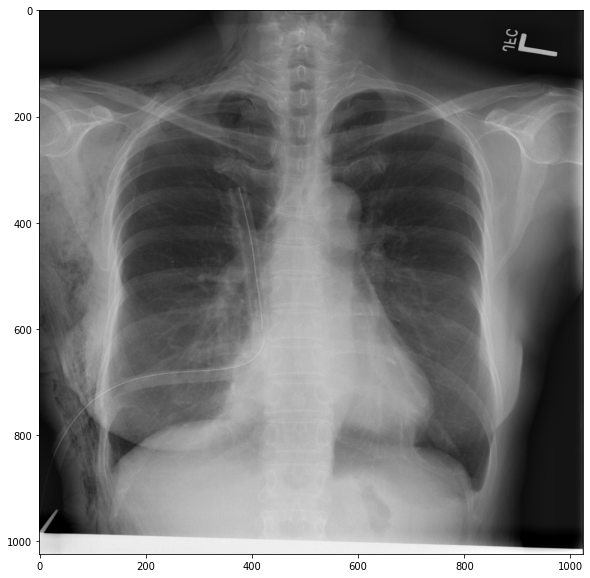

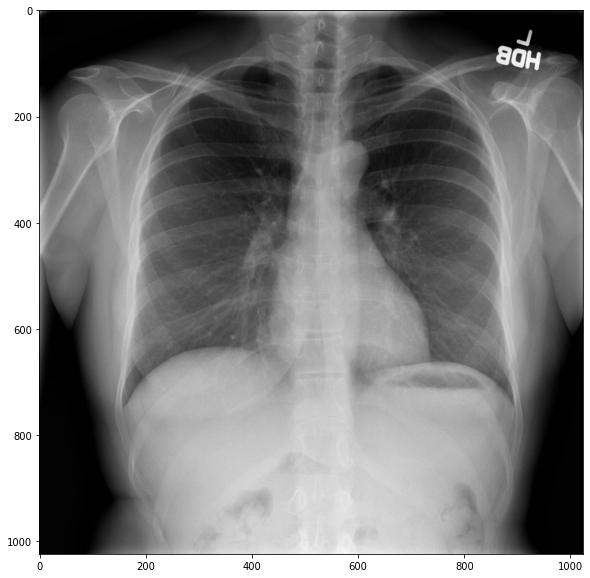

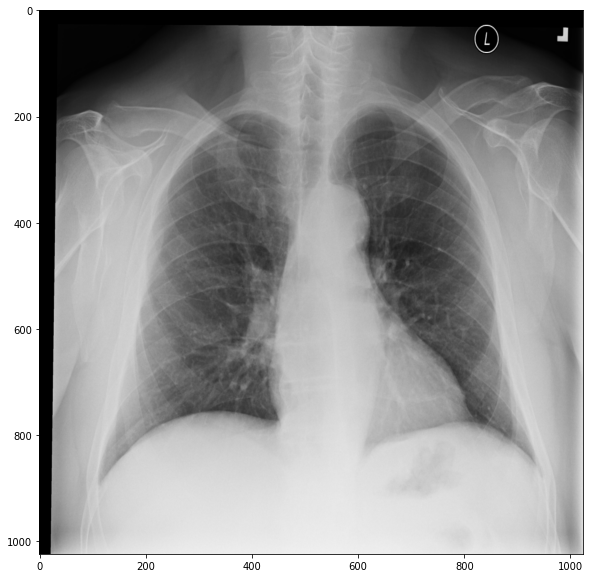

In [118]:
for img in imgs['imgs']:
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(img)